#Assignment 4: Feature Engineering

[![](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/drshahizan/Python_EDA/blob/ef2db3544a9df7111d9209dac788aa6f8fbe4a77/assignment/ass4/hpdp/3H/feature_eng.ipynb)


### Group Members

**Group Name:** 3H

| Name                                     | Matrix Number  
| :---------------------------------------- | :-------------: |
| NG ZI XING | A21EC0213
| MOHAMAD AZRI HADIF BIN MOHAMMAD RIZAL | A21EC0054
| ALIEYA ZAWANIE BINTI A ZAINI | A21EC0156
| IZZAT HAQEEMI BIN HAIRUDIN | A21EC0033



# About the Data

The dataset comprises information sourced from three distinct CSV files, totaling over 70 million records with 44 columns and a data size exceeding 8.0GB. Separating these files allows for systematic feature engineering without risking system crashes during the process.

# Motivation

The [Anime Data](https://www.kaggle.com/datasets/dbdmobile/myanimelist-dataset/) is sourced from Kaggle, focusing on anime—a widely popular form of entertainment originating from Japan. Anime encompasses a diverse range of animated content, including TV series, movies, and OVAs (original video animations), spanning various genres and target audiences. Known for its unique art style, engaging storytelling, and thematic diversity, anime covers genres such as action, adventure, comedy, drama, romance, fantasy, sci-fi, and more. With an extensive library of titles, recommendations play a pivotal role in aiding enthusiasts to discover new shows aligned with their interests. Recommendation systems leverage user ratings, genres, and other factors to suggest anime series, facilitating personalized content discovery.

# Goal

This notebook aims to utilize three primary CSV datasets—namely, anime-dataset-2023.csv, users-details-2023.csv, and users-score-2023.csv—to construct a comprehensive dataset. This dataset will serve as a foundation for the future development of an effective recommendation system.












>[Assignment 4: Feature Engineering](#scrollTo=YqEQWJseuYFT)

>>>[Group Members](#scrollTo=YqEQWJseuYFT)

>[About the Data](#scrollTo=YqEQWJseuYFT)

>[Motivation](#scrollTo=YqEQWJseuYFT)

>[Goal](#scrollTo=YqEQWJseuYFT)

>>[Loading Dataset](#scrollTo=vUiO_Qk_1ZbP)

>>>[Preparation](#scrollTo=gAhjMpMViabk)

>>[Importing Necessary Libraries](#scrollTo=7YYUO-G-DoQn)

>>>[Import User detail dataset](#scrollTo=lEFHGBU_iAiF)

>>>[Import anime dataset](#scrollTo=zdB94ovniJe-)

>>>[Importing User Score Dataset](#scrollTo=RRN6v2-FiOYo)

>>[Basic Exploratory Data Analysis (EDA)](#scrollTo=yS3x4kN3i6Q1)

>>>[User Detail](#scrollTo=DqC4EfLsjAHe)

>>>[Anime](#scrollTo=fXj2rnErjHGJ)

>>>[User Score](#scrollTo=ajjnnCBOjLQx)

>>[Basic Feature Selection](#scrollTo=JzLr79msjfGB)

>>>[User Detail](#scrollTo=4Y-x_1U8jlCD)

>>>[Anime](#scrollTo=9gRKj7BrjoHE)

>>>[User Score](#scrollTo=mP4-EdtNjvHY)

>>[Feature Preprocessing and Cleaning](#scrollTo=kZj3JAGpjY32)

>>>[User Detail](#scrollTo=Q_Lqh1U7kfwg)

>>>[Anime](#scrollTo=0-hGJ9U_kh0Q)

>>[Feature Transformation](#scrollTo=kuccDE65j4Jg)

>>>[User Detail](#scrollTo=B7cbqc1XkoVB)

>>>[Anime](#scrollTo=E3X1vRRpkrG0)

>>[Feature Creation and Further Feature Selection](#scrollTo=OW_AZyHpj9i_)

>>>[User Detail](#scrollTo=NHYja6TBkuhp)

>>>[Anime](#scrollTo=97HN4QqkkxFa)

>>>[User Score](#scrollTo=xhlhOK8CkyZP)

>>[Conclusion](#scrollTo=5CWSmyIuGebS)



## Loading Dataset

This notebook leverages the Kaggle official API to directly import the dataset into Colab. To proceed, you'll need the "kaggle.json" file. Follow these steps to obtain it:

1. Visit the Kaggle website.
2. Navigate to your profile and access account settings.
3. Create a new token.
4. Download the "kaggle.json" file.

Once you have the "kaggle.json" file, execute the cell below and upload your "kaggle.json" file.


In [ ]:
from google.colab import files

files.upload()
!mkdir ~/.kaggle
!mv kaggle.json ~/.kaggle
!chmod 600 ~/.kaggle/kaggle.json
!kaggle datasets download -d dbdmobile/myanimelist-dataset

Saving kaggle.json to kaggle.json
 99% 1.78G/1.80G [00:19<00:00, 114MB/s]
100% 1.80G/1.80G [00:19<00:00, 100MB/s]


### Preparation

## Importing Necessary Libraries

To facilitate the analysis and implementation of machine learning models, this notebook makes use of several essential libraries. Ensure you have these libraries installed by running the following commands.


In [ ]:
!pip install -U tensorflow
!pip install tensorflow_hub
!pip install tensorflow_text
!pip install -U scikit-learn

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf
import tensorflow_hub as hub
import tensorflow_text as text
from zipfile import ZipFile
import gc

Extract the downloaded zip data

In [ ]:
filepath = "/content/myanimelist-dataset.zip"

with ZipFile(filepath) as zip:
  zip.printdir()
  zip.extractall()

!rm /content/myanimelist-dataset.zip

File Name                                             Modified             Size
anime-dataset-2023.csv                         2023-07-28 04:36:40     15924739
anime-filtered.csv                             2023-07-28 04:36:40      9722413
final_animedataset.csv                         2023-07-28 04:37:18   4549801910
user-filtered.csv                              2023-07-28 04:41:36   1545214210
users-details-2023.csv                         2023-07-28 04:43:10     73927314
users-score-2023.csv                           2023-07-28 04:43:14   1157881770


### Import User detail dataset

**Brief Structure of users-details-2023.csv**
- **Mal ID:** Unique ID for each user.
- **Username:** The username of the user.
- **Gender:** The gender of the user.
- **Birthday:** The birthday of the user (in ISO format).
- **Location:** The location or country of the user.
- **Joined:** The date when the user joined the platform (in ISO format).
- **Days Watched:** The total number of days the user has spent watching anime.
- **Mean Score:** The average score given by the user to the anime they have watched.
- **Watching:** The number of anime currently being watched by the user.
- **Completed:** The number of anime completed by the user.
- **On Hold:** The number of anime on hold by the user.
- **Dropped:** The number of anime dropped by the user.
- **Plan to Watch:** The number of anime the user plans to watch in the future.
- **Total Entries:** The total number of anime entries in the user's list.
- **Rewatched:** The number of anime rewatched by the user.
- **Episodes Watched:** The total number of episodes watched by the user.

In [ ]:
user_detail = pd.read_csv("/content/users-details-2023.csv", index_col = 0)
user_detail.head()

,Username,Gender,Birthday,Location,Joined,Days Watched,Mean Score,Watching,Completed,On Hold,Dropped,Plan to Watch,Total Entries,Rewatched,Episodes Watched
Mal ID,,,,,,,,,,,,,,,
1,Xinil,Male,1985-03-04T00:00:00+00:00,California,2004-11-05T00:00:00+00:00,142.3,7.37,1.0,233.0,8.0,93.0,64.0,399.0,60.0,8458.0
3,Aokaado,Male,NaN,"Oslo, Norway",2004-11-11T00:00:00+00:00,68.6,7.34,23.0,137.0,99.0,44.0,40.0,343.0,15.0,4072.0
4,Crystal,Female,NaN,"Melbourne, Australia",2004-11-13T00:00:00+00:00,212.8,6.68,16.0,636.0,303.0,0.0,45.0,1000.0,10.0,12781.0
9,Arcane,NaN,NaN,NaN,2004-12-05T00:00:00+00:00,30.0,7.71,5.0,54.0,4.0,3.0,0.0,66.0,0.0,1817.0
18,Mad,NaN,NaN,NaN,2005-01-03T00:00:00+00:00,52.0,6.27,1.0,114.0,10.0,5.0,23.0,153.0,42.0,3038.0


In [ ]:
# change the index name to "user_id" instead of "Mal ID"

user_detail.index.name = "user_id"

### Import anime dataset

**Brief structure of anime-dataset-2023.csv**
- **anime_id:** Unique ID for each anime.
- **Name:** The name of the anime in its original language.
- **English name:** The English name of the anime.
- **Other name:** Native name or title of the anime (can be in Japanese, Chinese, or Korean).
- **Score:** The score or rating given to the anime.
- **Genres:** The genres of the anime, separated by commas.
- **Synopsis:** A brief description or summary of the anime's plot.
- **Type:** The type of the anime (e.g., TV series, movie, OVA, etc.).
- **Episodes:** The number of episodes in the anime.
- **Aired:** The dates when the anime was aired.
- **Premiered:** The season and year when the anime premiered.
- **Status:** The status of the anime (e.g., Finished Airing, Currently Airing, etc.).
- **Producers:** The production companies or producers of the anime.
- **Licensors:** The licensors of the anime (e.g., streaming platforms).
- **Studios:** The animation studios that worked on the anime.
- **Source:** The source material of the anime (e.g., manga, light novel, original).
- **Duration:** The duration of each episode.
- **Rating:** The age rating of the anime.
- **Rank:** The rank of the anime based on popularity or other criteria.
- **Popularity:** The popularity rank of the anime.
- **Favorites:** The number of times the anime was marked as a favorite by users.
- **Scored By:** The number of users who scored the anime.
- **Members:** The number of members who have added the anime to their list on the platform.
- **Image URL:** The URL of the anime's image or poster.

In [ ]:
anime = pd.read_csv("/content/anime-dataset-2023.csv", index_col = 0)
anime.head()

,Name,English name,Other name,Score,Genres,Synopsis,Type,Episodes,Aired,Premiered,...,Studios,Source,Duration,Rating,Rank,Popularity,Favorites,Scored By,Members,Image URL
anime_id,,,,,,,,,,,,,,,,,,,,,
1,Cowboy Bebop,Cowboy Bebop,カウボーイビバップ,8.75,"Action, Award Winning, Sci-Fi","Crime is timeless. By the year 2071, humanity ...",TV,26.0,"Apr 3, 1998 to Apr 24, 1999",spring 1998,...,Sunrise,Original,24 min per ep,R - 17+ (violence & profanity),41.0,43,78525,914193.0,1771505,https://cdn.myanimelist.net/images/anime/4/196...
5,Cowboy Bebop: Tengoku no Tobira,Cowboy Bebop: The Movie,カウボーイビバップ 天国の扉,8.38,"Action, Sci-Fi","Another day, another bounty—such is the life o...",Movie,1.0,"Sep 1, 2001",UNKNOWN,...,Bones,Original,1 hr 55 min,R - 17+ (violence & profanity),189.0,602,1448,206248.0,360978,https://cdn.myanimelist.net/images/anime/1439/...
6,Trigun,Trigun,トライガン,8.22,"Action, Adventure, Sci-Fi","Vash the Stampede is the man with a $$60,000,0...",TV,26.0,"Apr 1, 1998 to Sep 30, 1998",spring 1998,...,Madhouse,Manga,24 min per ep,PG-13 - Teens 13 or older,328.0,246,15035,356739.0,727252,https://cdn.myanimelist.net/images/anime/7/203...
7,Witch Hunter Robin,Witch Hunter Robin,Witch Hunter ROBIN (ウイッチハンターロビン),7.25,"Action, Drama, Mystery, Supernatural",Robin Sena is a powerful craft user drafted in...,TV,26.0,"Jul 3, 2002 to Dec 25, 2002",summer 2002,...,Sunrise,Original,25 min per ep,PG-13 - Teens 13 or older,2764.0,1795,613,42829.0,111931,https://cdn.myanimelist.net/images/anime/10/19...
8,Bouken Ou Beet,Beet the Vandel Buster,冒険王ビィト,6.94,"Adventure, Fantasy, Supernatural",It is the dark century and the people are suff...,TV,52.0,"Sep 30, 2004 to Sep 29, 2005",fall 2004,...,Toei Animation,Manga,23 min per ep,PG - Children,4240.0,5126,14,6413.0,15001,https://cdn.myanimelist.net/images/anime/7/215...


### Importing User Score Dataset

This CSV file, "users-score-2023.csv," contains data detailing user ratings for various anime titles. The objective is to predict the score that a user will assign to a particular anime.

**Brief Structure of users-score-2023.csv:**
- **user_id:** Unique identifier for each user.
- **Username:** The username associated with the user.
- **anime_id:** Unique identifier for each anime.
- **Anime Title:** The title of the anime.
- **rating:** The user's rating for the respective anime.

The "rating" column in this CSV serves as the target variable for prediction, representing the anticipated score that a user will give to a specific anime.


In [ ]:
user_score = pd.read_csv("/content/users-score-2023.csv")
user_score.head()

,user_id,Username,anime_id,Anime Title,rating
0,1,Xinil,21,One Piece,9
1,1,Xinil,48,.hack//Sign,7
2,1,Xinil,320,A Kite,5
3,1,Xinil,49,Aa! Megami-sama!,8
4,1,Xinil,304,Aa! Megami-sama! Movie,8


## Basic Exploratory Data Analysis (EDA)

This section focuses on gaining insights into the fundamental aspects of each column in the dataset. The analysis encompasses:

- **Values Composition:** Understanding the composition of values within each column.
- **Data Types:** Identifying the data types associated with each column.
- **Missing Values:** Assessing the presence of missing values, if any, to inform subsequent data handling strategies.

This initial exploration is crucial for laying the groundwork for further analysis and streamlining the workflow.


### User Detail

From the information provided below, it's evident that the dataset comprises a total of 731,290 users. The presence of non-null values in some columns indicates the absence of NaN values, while columns with misaligned non-null counts suggest the presence of NaN values. The data types include 'object' and 'float64,' with the observation that the 'Birthday' column should ideally have a date data type.

Further exploration will focus on examining columns with missing values one by one to better understand and address any potential data gaps.


In [ ]:
user_detail.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 731290 entries, 1 to 1291097
Data columns (total 15 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Username          731290 non-null  object 
 1   Gender            224383 non-null  object 
 2   Birthday          168068 non-null  object 
 3   Location          152806 non-null  object 
 4   Joined            731290 non-null  object 
 5   Days Watched      731282 non-null  float64
 6   Mean Score        731282 non-null  float64
 7   Watching          731282 non-null  float64
 8   Completed         731282 non-null  float64
 9   On Hold           731282 non-null  float64
 10  Dropped           731282 non-null  float64
 11  Plan to Watch     731282 non-null  float64
 12  Total Entries     731282 non-null  float64
 13  Rewatched         731282 non-null  float64
 14  Episodes Watched  731282 non-null  float64
dtypes: float64(10), object(5)
memory usage: 89.3+ MB


It appears that the "Username" column primarily contains seemingly meaningless strings that contribute minimally to predicting the rating value. Therefore, considering its limited relevance, it could be a candidate for removal in subsequent stages of the analysis to streamline the dataset and improve computational efficiency.


In [ ]:
user_detail.Username.unique()[:20]

array(['Xinil', 'Aokaado', 'Crystal', 'Arcane', 'Mad', 'vondur', 'Amuro',
       'Baman', 'beddan', 'kei-clone', 'Ladholyman', 'Hiromi', 'Cruzle',
       'Smoka', 'Emp', 'koalatees', 'Achtor', 'jaames', 'xich',
       'marvin_9martian'], dtype=object)

The "Gender" column exhibits three distinct categories and includes NaN values. Further exploration and decision-making are warranted to handle these missing values, potentially through imputation or considering their impact on the analysis.


In [ ]:
print( user_detail.Gender.unique() )

['Male' 'Female' nan 'Non-Binary']


The "Birthday" column contains numerous null values, and it's noted that the correct data type for this column should be a date. Subsequent steps in the analysis should involve addressing these missing values and ensuring the proper conversion of the "Birthday" column to the appropriate date data type.


In [ ]:
user_detail.Birthday.head()

user_id
1     1985-03-04T00:00:00+00:00
3                           NaN
4                           NaN
9                           NaN
18                          NaN
Name: Birthday, dtype: object

The "Location" column appears to contain numerous seemingly meaningless strings, posing challenges for easy detection and removal. A more in-depth examination or preprocessing steps may be necessary to handle or mitigate the impact of these potentially irrelevant or noisy values on the analysis.


In [ ]:
user_detail.Location.unique()[:30]

array(['California', 'Oslo, Norway', 'Melbourne, Australia', nan,
       'Bergen, Norway', 'Canada', 'Land of Rain and Fjords',
       '31f288172a11dea9f2781a6d87e0a200', 'Calgary, AB', 'Paris, France',
       'Seattle, Washington', 'Latvia', "good ol' Europe",
       'London,England', 'Lule&aring;, Sweden', 'Ontario, Canada', 'UAE',
       'Locked up in Shuuka basement working on cards :p',
       'Tampere, Finland', 'Finland, Pori', 'Drøbak, Norway',
       'Yorba Linda, California', 'Pandan Jaya', 'New york',
       'Johor, Malaysia', 'Netherlands', 'Michigan', 'Helsinki, Finland',
       'Hamilton, Ontario', 'Wilmington, North Carolina'], dtype=object)

For the remaining columns with missing values, it's observed that they all share the same 8 records with missing values. Given this small number, a straightforward approach could involve removing these records during the data cleaning phase to mitigate their impact on the analysis.


In [ ]:
user_detail[ user_detail["Days Watched"].isna() ]

,Username,Gender,Birthday,Location,Joined,Days Watched,Mean Score,Watching,Completed,On Hold,Dropped,Plan to Watch,Total Entries,Rewatched,Episodes Watched
user_id,,,,,,,,,,,,,,,
8682,DeleteMe3409,Female,NaN,NaN,2007-07-27T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
79090,rosycrystals,Female,1993-11-29T00:00:00+00:00,Kansas,2008-07-23T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
125668,BlazingDevil,Male,1995-07-07T00:00:00+00:00,Kamloops British Columbia in Canada,2008-12-20T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
160113,FuckedUpProfile,Female,1993-06-19T00:00:00+00:00,Organisation 13,2009-03-17T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
231825,Account_Closed,Female,1994-04-22T00:00:00+00:00,"Portersville, Pennsylvania",2009-09-08T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
232646,-Lovely-,Female,1994-04-22T00:00:00+00:00,"Portersville,Pennsylvania",2009-09-10T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
277237,sarah_sweet,Female,1997-08-14T00:00:00+00:00,Romania,2010-01-02T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
561555,RaisinMuffins,Male,NaN,NaN,2011-08-31T00:00:00+00:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Anime

The anime data appears to be well-structured, with most columns having the correct data types. This suggests that minimal preprocessing may be required for this dataset, contributing to a smoother integration into the overall analysis workflow.


In [ ]:
anime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24905 entries, 1 to 55735
Data columns (total 23 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Name          24905 non-null  object
 1   English name  24905 non-null  object
 2   Other name    24905 non-null  object
 3   Score         24905 non-null  object
 4   Genres        24905 non-null  object
 5   Synopsis      24905 non-null  object
 6   Type          24905 non-null  object
 7   Episodes      24905 non-null  object
 8   Aired         24905 non-null  object
 9   Premiered     24905 non-null  object
 10  Status        24905 non-null  object
 11  Producers     24905 non-null  object
 12  Licensors     24905 non-null  object
 13  Studios       24905 non-null  object
 14  Source        24905 non-null  object
 15  Duration      24905 non-null  object
 16  Rating        24905 non-null  object
 17  Rank          24905 non-null  object
 18  Popularity    24905 non-null  int64 
 19  Favo

Despite the appearance of completeness, it's revealed that missing values in the anime data are, in fact, represented by the "UNKNOWN" string. Subsequent steps involve replacing "UNKNOWN" with the appropriate representation, such as `None`. Further examination is needed to understand the internal structure of these missing values and devise strategies for handling them in the analysis.


In [ ]:
anime.replace("UNKNOWN", None, inplace = True)
anime.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24905 entries, 1 to 55735
Data columns (total 23 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   Name          24905 non-null  object
 1   English name  10328 non-null  object
 2   Other name    24777 non-null  object
 3   Score         15692 non-null  object
 4   Genres        19976 non-null  object
 5   Synopsis      24905 non-null  object
 6   Type          24831 non-null  object
 7   Episodes      24294 non-null  object
 8   Aired         24905 non-null  object
 9   Premiered     5506 non-null   object
 10  Status        24905 non-null  object
 11  Producers     11555 non-null  object
 12  Licensors     4735 non-null   object
 13  Studios       14379 non-null  object
 14  Source        24905 non-null  object
 15  Duration      24905 non-null  object
 16  Rating        24236 non-null  object
 17  Rank          20293 non-null  object
 18  Popularity    24905 non-null  int64 
 19  Favo

The "Name" column exhibits no missing values, while both the "English Name" and "Other Name" columns contain a substantial number of missing values. Considering that the "Name" column serves as a representative with potential translation bias, a decision may be made to remove the "English Name" and "Other Name" columns directly during subsequent stages of the analysis.


In [ ]:
print( "Unknown Name: ", anime["Name"].isna().sum())
print( "Unknown English Name: ", anime["English name"].isna().sum())
print( "Unknown Other Name: ", anime["Other name"].isna().sum())

Unknown Name:  0
Unknown English Name:  14577
Unknown Other Name:  128


An interesting observation is that the "Score" and "Scored By" columns consistently have missing values together. Furthermore, analyzing their unique values indicates that their data type should be float. Addressing these missing values may involve imputation or other strategies to ensure the proper representation of these numeric columns in the dataset.


In [ ]:
print("Score and Score by column is None together: ", ( anime["Score"].isna() * anime["Scored By"].isna() ).sum() )
print("Score not None and Score by is None : ", ( anime["Score"].notna() * anime["Scored By"].isna() ).sum() )
print("Score is None and Score by not None: ", ( anime["Score"].isna() * anime["Scored By"].notna() ).sum() )

Score and Score by column is None together:  9213
Score not None and Score by is None :  0
Score is None and Score by not None:  0


In [ ]:
anime.Score.unique()[:10]

array(['8.75', '8.38', '8.22', '7.25', '6.94', '7.92', '8.0', '7.55',
       '8.16', '8.87'], dtype=object)

In [ ]:
anime["Scored By"].unique()[:10]

array(['914193.0', '206248.0', '356739.0', '42829.0', '6413.0', '86524.0',
       '81747.0', '12960.0', '97878.0', '368569.0'], dtype=object)

The "Type" column exhibits a very low percentage of missing values. A strategy for handling these missing values could involve creating a new class, such as "UNK," to represent this category during subsequent data processing stages.


In [ ]:
anime.Type.isna().sum() / anime.shape[0]

0.0029712909054406744

Handling the "Genres," "Producers," "Licensors," and "Studios" columns presents a challenge due to their multi-category nature. An effective strategy is to convert each category into one-hot columns during later stages of analysis. This approach ensures that null values in these columns will be represented by all-zero one-hot columns, simplifying their treatment and integration into the dataset.


In [ ]:
anime[["Genres", "Producers", "Licensors", "Studios"]].head()

,Genres,Producers,Licensors,Studios
anime_id,,,,
1,"Action, Award Winning, Sci-Fi",Bandai Visual,"Funimation, Bandai Entertainment",Sunrise
5,"Action, Sci-Fi","Sunrise, Bandai Visual",Sony Pictures Entertainment,Bones
6,"Action, Adventure, Sci-Fi",Victor Entertainment,"Funimation, Geneon Entertainment USA",Madhouse
7,"Action, Drama, Mystery, Supernatural","Bandai Visual, Dentsu, Victor Entertainment, T...","Funimation, Bandai Entertainment",Sunrise
8,"Adventure, Fantasy, Supernatural","TV Tokyo, Dentsu",Illumitoon Entertainment,Toei Animation


Given the apparent lack of internal relationships between the categories in the "Genres," "Producers," "Licensors," and "Studios" columns, deriving a suitable null value replacement strategy becomes essential. This involves careful consideration of the dataset characteristics and potential alternatives for filling or representing missing values in these categorical columns.


In [ ]:
anime[["Type", "Studios", "Producers", "Licensors"]].groupby("Type").agg(lambda x: x.notna().sum())

,Studios,Producers,Licensors
Type,,,
Movie,2260,1576,697
Music,505,1111,3
ONA,1749,1135,113
OVA,3099,2523,1090
Special,1865,955,495
TV,4888,4242,2337


Drawing on domain knowledge, it's evident that the "Episodes" column has a direct relationship with the type of anime. For instance, if the type is a "Movie," it's common for the number of episodes to be 1. The results from the group-by operation align with this assumption, supporting the notion that the "Episodes" column can potentially be imputed based on the anime type.


In [ ]:
anime[["Type", "Episodes"]].groupby("Type").agg(pd.Series.mode)

,Episodes
Type,
Movie,1.0
Music,1.0
ONA,1.0
OVA,1.0
Special,1.0
TV,12.0


An observation reveals that the "Anime Premiered" column is a direct conversion from the "Aired" column. Given that the "Aired" column is complete, a reasonable strategy for null value replacement in the "Anime Premiered" column involves inference from the corresponding values in the "Aired" column.


In [ ]:
anime.Premiered.unique()[:20]

array(['spring 1998', None, 'summer 2002', 'fall 2004', 'spring 2005',
       'fall 2002', 'spring 2004', 'fall 1999', 'fall 2001',
       'spring 2003', 'fall 1995', 'fall 1997', 'winter 1996',
       'spring 2002', 'winter 2005', 'spring 2001', 'spring 1999',
       'fall 2003', 'summer 2003', 'summer 2004'], dtype=object)

In [ ]:
anime.Aired.unique()[:20]

array(['Apr 3, 1998 to Apr 24, 1999', 'Sep 1, 2001',
       'Apr 1, 1998 to Sep 30, 1998', 'Jul 3, 2002 to Dec 25, 2002',
       'Sep 30, 2004 to Sep 29, 2005', 'Apr 6, 2005 to Mar 19, 2008',
       'Apr 15, 2005 to Sep 27, 2005', 'Sep 11, 2002 to Sep 10, 2003',
       'Apr 17, 2004 to Feb 18, 2006', 'Apr 7, 2004 to Sep 28, 2005',
       'Oct 3, 2002 to Feb 8, 2007', 'Oct 20, 1999 to ?',
       'Oct 10, 2001 to Mar 23, 2005', 'Oct 6, 2004 to Dec 15, 2004',
       'Oct 5, 2004 to Mar 29, 2005', 'Oct 6, 2004 to Mar 30, 2005',
       'Apr 17, 2003 to Sep 25, 2003', 'Apr 29, 2005 to Oct 28, 2005',
       'Oct 12, 2004 to Mar 14, 2006', 'Oct 8, 2004 to Apr 1, 2005'],
      dtype=object)

In [ ]:
print( "NaN in Aired: ", anime.Aired.isna().sum() / anime.shape[0] )
print( "NaN in Premiered: ", anime.Premiered.isna().sum() / anime.shape[0] )

NaN in Aired:  0.0
NaN in Premiered:  0.7789198956032926


The percentage of missing values in the "Rank" and "Rating" columns is deemed acceptable. A suitable strategy for handling these missing values during later preprocessing stages may involve imputing the values using the mean or median, ensuring a balanced approach to maintaining data integrity.


In [ ]:
print( "NaN percentage in Rank: ", anime.Rank.isna().sum() / anime.shape[0] )
print( "NaN percentage in Rating: ", anime.Rating.isna().sum() / anime.shape[0] )

NaN percentage in Rank:  0.18518369805259988
NaN percentage in Rating:  0.026862075888375827


### User Score

Fortunately, the user score data is complete without further analysis. However, some columns, such as anime name and user name, may contribute less to predicting the rating. These columns are potential candidates for handling in the next session, where further preprocessing and feature selection can be performed to streamline the dataset and enhance the model's predictive capabilities.


In [ ]:
user_score.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24325191 entries, 0 to 24325190
Data columns (total 5 columns):
 #   Column       Dtype 
---  ------       ----- 
 0   user_id      int64 
 1   Username     object
 2   anime_id     int64 
 3   Anime Title  object
 4   rating       int64 
dtypes: int64(3), object(2)
memory usage: 927.9+ MB


## Basic Feature Selection

In this session, basic and simple feature selection will be conducted primarily based on domain knowledge. More detailed feature selection will be performed in subsequent sessions, refining the process and ensuring a comprehensive approach to enhance the dataset's predictive power.


### User Detail

To enhance the predictive capabilities of the model, the following columns will be dropped due to their perceived lesser contribution to the rating, based on domain knowledge:

- Username
- Location
- Joined

This initial feature selection aims to streamline the dataset, and further refinements can be made in subsequent sessions.


In [ ]:
user_detail.drop( ["Username", "Location", "Joined"], axis = 1, inplace = True)

### Anime


Considering common sense and practicality, the "Name" column, despite its potential representativeness, will be dropped. It is reasoned that the likelihood of people making ratings solely based on the name is low. Additionally, the "Image URL" column, which is challenging to handle, will also be removed.


In [ ]:
anime.drop([ "Name",  "English name", "Other name", "Image URL"], axis = 1, inplace = True)

### User Score

Reiterating the importance of focusing on key features for our goal, both the "Username" and "Anime Name" columns, which are considered less impactful for rating prediction, will be dropped.


In [ ]:
user_score.drop(["Username", "Anime Title"], axis = 1, inplace = True)

## Feature Preprocessing and Cleaning

This step encompasses handling missing values, converting data formats to enhance accessibility in subsequent workflows, and ensuring the correct data types for effective analysis.


### User Detail

For the "Gender" column, which has an acceptable percentage of missing values, a reasonable approach involves replacing these missing values with a pseudo new class, represented by "UNK" (unknown). This strategy aims to allow the machine learning model to potentially learn generalized rules from this additional category, contributing to a more robust predictive performance.


In [ ]:
print( user_detail.Gender.unique() )
user_detail.Gender.fillna("UNK", inplace = True)

print( user_detail.Gender.unique() )
print(f"Null Value: {user_detail.Gender.isna().sum()}")

['Male' 'Female' nan 'Non-Binary']
['Male' 'Female' 'UNK' 'Non-Binary']
Null Value: 0


For the "Birthday" column, a check_date function will be constructed to convert the date format to the correct np.datetime64 datatype. The function logic is as follows:

- If the record is None, return None (to be replaced by the mode later).
- If the date range is within the correct range, return the datetime value.
- If not, return None (to handle cases where users input invalid date values, such as 0001-01-01, which can lead to overflow when directly converted to np.datetime64).


In [ ]:
def check_date(row):

  if pd.isnull(row):
    return row

  row = np.datetime64(row.split("T")[0])
  if (row >= np.datetime64(pd.Timestamp.min)  ) and ( row <= np.datetime64(pd.Timestamp.max) ):
    return row

  return None

In [ ]:
user_detail["Birthday"] = user_detail.Birthday.apply(check_date)
user_detail["Birthday"].fillna( np.datetime64(user_detail["Birthday"].mode()[0]), inplace = True ) #fill the null value by mode

As discussed earlier, the remaining columns with None values share the same 8 records. To address this, a straightforward approach involves dropping these records, ensuring the removal of the corresponding missing values from the dataset.


In [ ]:
user_detail[ user_detail["Days Watched"].isna() ]
user_detail.dropna(inplace = True)

In [ ]:
user_detail.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 731282 entries, 1 to 1291097
Data columns (total 12 columns):
 #   Column            Non-Null Count   Dtype         
---  ------            --------------   -----         
 0   Gender            731282 non-null  object        
 1   Birthday          731282 non-null  datetime64[ns]
 2   Days Watched      731282 non-null  float64       
 3   Mean Score        731282 non-null  float64       
 4   Watching          731282 non-null  float64       
 5   Completed         731282 non-null  float64       
 6   On Hold           731282 non-null  float64       
 7   Dropped           731282 non-null  float64       
 8   Plan to Watch     731282 non-null  float64       
 9   Total Entries     731282 non-null  float64       
 10  Rewatched         731282 non-null  float64       
 11  Episodes Watched  731282 non-null  float64       
dtypes: datetime64[ns](1), float64(10), object(1)
memory usage: 72.5+ MB


For the "Mean Score" column, some values may fall outside the expected range of 0 to 10. To address this, a simple approach is to clip these values, ensuring that they are constrained within the correct range for mean scores.


In [ ]:
user_detail["Mean Score"] = user_detail["Mean Score"].where( user_detail["Mean Score"] <= 10,  10 )
user_detail["Mean Score"] = user_detail["Mean Score"].where( user_detail["Mean Score"] >= 0,  0 )

### Anime

Given the observation that the "Score" and "Scored By" columns consistently have missing values together, it's reasonable to assume that no one has rated these anime. Consequently, both columns can be set to 0 for these cases, reflecting the absence of ratings.


In [ ]:
anime[["Score", "Scored By"]] = anime[["Score", "Scored By"]].fillna(0)
anime[["Score", "Scored By"]] = anime[["Score", "Scored By"]].astype(float)

Next, we will handle columns with multiple categories in a single cell, such as "Genres," "Producers," "Licensors," and "Studios." It's crucial to note that replacing None values with any category, such as mode, is inappropriate. For example, an anime with type TV without licensors is a valid scenario by domain knowledge. Instead, we will convert these columns into one-hot encoded format. This means that a record with a null value will have all zeros in each one-hot column. However, it's important to be mindful of the potential drawback of dimension explosion.


In [ ]:
#the get_unique collect is to collect the available categories from each record of the column

def get_unique(col):
  uni = set()
  for i in anime[col].str.split(","):
    if i != None:
      uni = uni.union(i)

  return { u:i for i,u in enumerate(uni) }

genres = get_unique("Genres")
genres

{'Romance': 0,
 'Action': 1,
 ' Sci-Fi': 2,
 ' Mystery': 3,
 'Mystery': 4,
 ' Adventure': 5,
 'Sports': 6,
 ' Supernatural': 7,
 'Gourmet': 8,
 ' Comedy': 9,
 'Avant Garde': 10,
 'Boys Love': 11,
 ' Avant Garde': 12,
 'Supernatural': 13,
 'Girls Love': 14,
 ' Boys Love': 15,
 'Suspense': 16,
 'Slice of Life': 17,
 'Erotica': 18,
 'Fantasy': 19,
 ' Drama': 20,
 ' Ecchi': 21,
 ' Fantasy': 22,
 'Sci-Fi': 23,
 'Award Winning': 24,
 ' Romance': 25,
 'Drama': 26,
 'Horror': 27,
 'Comedy': 28,
 ' Award Winning': 29,
 ' Suspense': 30,
 ' Hentai': 31,
 ' Horror': 32,
 'Adventure': 33,
 ' Gourmet': 34,
 'Ecchi': 35,
 'Hentai': 36,
 ' Girls Love': 37,
 ' Slice of Life': 38,
 ' Sports': 39,
 ' Erotica': 40}

In [ ]:
#utilize the outcome from get_unique to encode the records into one hot string (such as "00101")
def gen_one_hot(row, uni):

  if row == None:
    return " ".join(["0"] * len(uni)) #None records will obtain all zero value

  cls = row.split(",")
  row = ["0"] * len(uni)

  for c in cls:
    row[ uni[c] ] = "1"


  return " ".join(row)

#convert the column into one hot
def split_cls(col, prefix, splitter = " ", datatype = bool):

  uni = get_unique(col)
  anime[ [ prefix +  k for k in uni.keys() ] ] = anime[col].apply(gen_one_hot, uni = uni).str.split(splitter, expand = True).astype(int).astype(bool)
  anime.drop(col, axis = 1, inplace = True)


Observing the transformation, each category in the "Genres" column has been converted into a specific column, and the datatype has been set to boolean. This not only captures the categorical information effectively but also optimizes memory usage by utilizing boolean values instead of integers.


In [ ]:
split_cls("Genres", "genres_")
anime.iloc[:, anime.columns.str.startswith("genres_") ].sample(10)

,genres_Romance,genres_Action,genres_ Sci-Fi,genres_ Mystery,genres_Mystery,genres_ Adventure,genres_Sports,genres_ Supernatural,genres_Gourmet,genres_ Comedy,...,genres_ Hentai,genres_ Horror,genres_Adventure,genres_ Gourmet,genres_Ecchi,genres_Hentai,genres_ Girls Love,genres_ Slice of Life,genres_ Sports,genres_ Erotica
anime_id,,,,,,,,,,,,,,,,,,,,,
22973,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
2946,False,True,False,False,False,False,False,False,False,False,...,True,False,False,False,False,False,False,False,False,False
51521,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
35281,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
48392,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,True,False,False,False,False
45028,False,True,True,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
42726,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
48517,False,False,False,False,False,False,False,False,False,False,...,False,False,False,True,False,False,False,False,True,False
35278,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [ ]:
#same step for producers, licensors and studios
split_cls("Producers", "proc_")
split_cls("Licensors", "lic_")
split_cls("Studios", "stud_")

In [ ]:
#due to the previous step lead to dimension explode, lead to hard observe the other columns, we have to extract them one by one
columns = anime.columns[sum([ anime.columns.str.startswith(i)  for i in ["genres_", "proc_", "stud_", "lic_"]]) == 0]

Given the acceptable percentage of missing values in the "Type" column, a straightforward replacement strategy involves assigning a new pseudo class, "UNK" (unknown), to represent these missing values. This approach ensures that the imputation aligns with the overall data distribution while handling the missing values appropriately.


In [ ]:
anime["Type"].fillna("UNK", inplace = True)

Temporarily filling missing values in the "Episodes" column with zero and converting the datatype to float ensures that the dataset remains consistent and compatible for subsequent analysis.


In [ ]:
anime["Episodes"].fillna("0", inplace = True)
anime["Episodes"] = anime["Episodes"].astype(float)

Recognizing the close relationship between the "Episodes" and "Type" columns, a practical strategy involves grouping the data by anime and imputing the missing values in the "Episodes" column with the median value for each corresponding type.


In [ ]:
med_episodes = anime[["Episodes", "Type"]].groupby("Type").median()["Episodes"]

def replace_episodes(row):

  if row[0] == 0:
    row[0] = med_episodes[ row[1] ]
    return row

  return row

anime[["Episodes", "Type"]] = anime[["Episodes", "Type"]].apply(replace_episodes, axis = 1)

To efficiently handle the "Premiered" column, a function called replace_premiered will be constructed to derive the values from the "Aired" column. Following this replacement, the detailed "Date Aired" column, deemed unnecessary, will be dropped to streamline the dataset and eliminate redundant information.


In [ ]:
import re

#match each month to its corresponding spring
month = [ "Mar", "Apr", "May",  "Jun", "Jul", "Aug", "Sep", "Oct", "Nov" , "Dec", "Jan", "Feb" ]
premier = [ "spring", "summer", "fall", "winter" ]
month_to_premier = { month[i] : premier[ int(i/3) ] for i in range(12) }

def replace_premiered(row):

  # we just replace the null
  if row[0] != None:
    return row[0]

  month_p = re.compile("[a-zA-Z]{3}")
  year_p = re.compile("\d{4}")

  month = month_p.findall(row[1])
  month = "" if len(month) == 0 else month[0] #if no month exists, set it to empty string

  year = year_p.findall(row[1])
  year = "2024" if len(year) == 0 else year[0] # if no year exists, set it to 2024 year

  return  month_to_premier.get(month,"UNK") + " " + str(year)

In [ ]:
anime["Premiered"] = anime[["Premiered", "Aired"]].apply(replace_premiered, axis = 1)

In [ ]:
anime[ ["spring", "year"] ] = anime["Premiered"].str.split(" ", expand = True) #split the premiered column into spring and year
anime.drop(["Premiered", "Aired"], axis = 1, inplace = True)

columns = columns.drop(["Premiered", "Aired"])

In [ ]:
anime[columns].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 24905 entries, 1 to 55735
Data columns (total 13 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   Score       24905 non-null  float64
 1   Synopsis    24905 non-null  object 
 2   Type        24905 non-null  object 
 3   Episodes    24905 non-null  float64
 4   Status      24905 non-null  object 
 5   Source      24905 non-null  object 
 6   Duration    24905 non-null  object 
 7   Rating      24236 non-null  object 
 8   Rank        20293 non-null  object 
 9   Popularity  24905 non-null  int64  
 10  Favorites   24905 non-null  int64  
 11  Scored By   24905 non-null  float64
 12  Members     24905 non-null  int64  
dtypes: float64(3), int64(3), object(7)
memory usage: 2.7+ MB


To address missing values in the "Rating" column, a practical imputation strategy involves replacing these values with the mode of the column.


In [ ]:
freq_rate = anime["Rating"].mode()[0]
anime["Rating"].fillna( freq_rate, inplace = True )

For the "Rank" column, where missing values are present, a robust imputation strategy involves replacing these values with the median rather than the mean. This approach is particularly useful to mitigate the potential impact of outliers.


In [ ]:
anime["Rank"] = anime["Rank"].astype(float)
rank_med = anime["Rank"].mean()
anime["Rank"].fillna(rank_med, inplace = True)

## Feature Transformation

In this step, further exploratory data analysis (EDA) will be conducted, and specific columns will undergo transformation into more useful formats. Min-max scaling will be applied where appropriate. Additionally, for categorical columns, options such as one-hot encoding or numerical encoding through target encoding will be considered for further transformation.


In [ ]:
gc.collect() #collect rubbish memory

27

### User Detail

From the observed chart, it's apparent that each category in the "Gender" column has almost a similar distribution in mean score. This suggests that the "Gender" column may not contribute significantly to predicting mean scores, indicating its potential limited usefulness in the analysis.


<Axes: xlabel='Mean Score', ylabel='Density'>

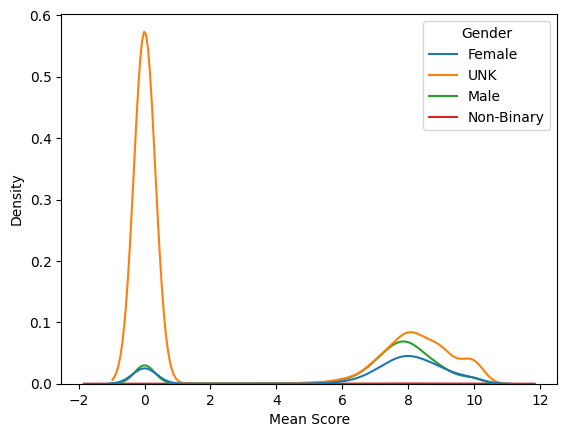

In [ ]:
sns.kdeplot( data = user_detail.sample(frac = 0.5), hue = "Gender", x = "Mean Score")

Converting gender column into one hot

In [ ]:
#transform the gender column into one hot

user_detail = pd.get_dummies( user_detail, columns = ["Gender"] )

Min max scaling the numerical columns

In [ ]:
def min_max_scaling(df):

  max_ = df.max()
  min_ = df.min()

  return ( df - min_ ) / (max_ - min_)

In [ ]:
columns = ['Days Watched', 'Watching', 'Completed', 'On Hold', 'Dropped', 'Plan to Watch', 'Total Entries', 'Rewatched', 'Episodes Watched', "Mean Score"]

user_detail[columns] = min_max_scaling(user_detail[columns])

### Anime

In [ ]:
#exclude columns of generes, producers, licensors and studios
columns = [c for c in anime.columns if "_" not in c ]

The rapid progress in Natural Language Processing, particularly with advancements like BERT, has significantly facilitated our work. Common sense dictates that the score of an anime should be highly dependent on its synopsis. However, the analysis of natural language format can be challenging. Using BERT, we can efficiently convert the sentences in the synopsis into a meaningful vector representation. This transformation greatly enhances the computer's understanding of the textual content, allowing for more effective analysis and feature representation.


In [ ]:
#import bert model and its corresponding preprocessor from tensorflow

bert = hub.load("https://www.kaggle.com/models/tensorflow/bert/frameworks/tensorFlow2/variations/bert-en-uncased-l-10-h-128-a-2/versions/2")
preprocessor = hub.load("https://kaggle.com/models/tensorflow/bert/frameworks/TensorFlow2/variations/en-uncased-preprocess/versions/3")

In [ ]:
#transform the synopsis into vector by bert
#this process take long time, can skip this cell to the next which can restore the vector directly

def preprocessing(row):

  return tf.reduce_mean( bert(preprocessor(row))["sequence_output"], axis = 1 )

#the data is batched into size of 128 due to limited gpu ram
synopsis_data = tf.data.Dataset.from_tensor_slices( anime["Synopsis"] ).batch(128).map(preprocessing).unbatch()
synopsis_vec = np.array([ d for d in synopsis_data.as_numpy_iterator() ])

In [ ]:
#if you have run the previous cell, please omit this cell

!wget "https://drive.google.com/uc?export=download&id=1-2_0th2_jC70U6CKsAt_CIn7ydXc6haw" -O synopsis_vec.npy
synopsis_vec = np.load("synopsis_vec.npy")

--2023-11-26 02:35:57--  https://drive.google.com/uc?export=download&id=1-2_0th2_jC70U6CKsAt_CIn7ydXc6haw
Resolving drive.google.com (drive.google.com)... 173.194.211.139, 173.194.211.102, 173.194.211.113, ...
Connecting to drive.google.com (drive.google.com)|173.194.211.139|:443... connected.
HTTP request sent, awaiting response... 303 See Other
Location: https://doc-14-98-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/r6840gfbuvd310nleu91sceqvor0tahi/1700966100000/11590239380845912113/*/1-2_0th2_jC70U6CKsAt_CIn7ydXc6haw?e=download&uuid=4157cab8-a5b5-4e6a-99aa-c0480577f193 [following]
--2023-11-26 02:35:59--  https://doc-14-98-docs.googleusercontent.com/docs/securesc/ha0ro937gcuc7l7deffksulhg5h7mbp1/r6840gfbuvd310nleu91sceqvor0tahi/1700966100000/11590239380845912113/*/1-2_0th2_jC70U6CKsAt_CIn7ydXc6haw?e=download&uuid=4157cab8-a5b5-4e6a-99aa-c0480577f193
Resolving doc-14-98-docs.googleusercontent.com (doc-14-98-docs.googleusercontent.com)... 142.251.107.132, 

TensorFlow provides TensorBoard, a powerful tool for visualizing vectors interactively. With TensorBoard, each vector represents a synopsis, and vectors with similar content in the synopsis should have closer representations. Please note that in the preview, TensorBoard may not be visible. Below is a screenshot demonstrating how to interact with TensorBoard. To fully experience the interactive features, it's recommended to open this notebook in Google Colab.


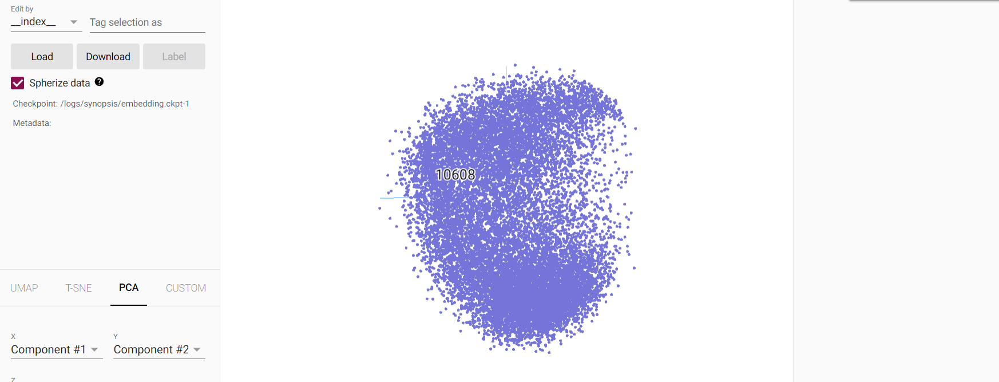

In [ ]:
import os
from tensorboard.plugins import projector

# Set up a logs directory, so Tensorboard knows where to look for files.
log_dir='/logs/synopsis/'
if not os.path.exists(log_dir):
    os.makedirs(log_dir)

#to reduce file size, only 0.8 of vec is selected
weights = tf.Variable(synopsis_vec[np.random.choice(synopsis_vec.shape[0],int(synopsis_vec.shape[0]*0.8), replace = False ), :], name = "embedding")
checkpoint = tf.train.Checkpoint(embedding=weights)
checkpoint.save(os.path.join(log_dir, "embedding.ckpt"))

# Set up config.
config = projector.ProjectorConfig()
embedding = config.embeddings.add()
embedding.tensor_name = "embedding"
embedding.metadata_path = 'metadata.tsv'
projector.visualize_embeddings(log_dir, config)

%load_ext tensorboard
%tensorboard --logdir /logs/synopsis/

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

**If the tensorboard does not show anything, please click the inactive, drop down to the bottom and select projector**

In [ ]:
#we are not longer need synopsis column
anime.drop("Synopsis", axis = 1, inplace = True)

To address the dimension explosion resulting from the separation of categories in the "Genres," "Licensors," "Producers," and "Studios" columns into one-hot encoding, a target encoding approach will be employed. This involves calculating the target encoding for each one-hot category, taking the mean, and consolidating the information into a single column by taking mean again  for each category. This strategy helps mitigate the dimensionality issue while preserving the valuable information contained in these columns.


In [ ]:
from sklearn.preprocessing import TargetEncoder

def target_encoding(start):

  columns = anime.columns[ anime.columns.str.startswith(start) ]

  #the rating score in user_score date is the final value we will predict so we have to merge them
  #due to the limited memory and avoid overfitting, we only sampling 0.01 percent of data, but the amount of data still large enough
  data = user_score[["anime_id", "rating"]].sample(frac = 0.01).merge(anime[columns], left_on = "anime_id", right_index = True).drop("anime_id", axis = 1)
  data["rating"] = data.rating.astype("float64")
  x = np.zeros((anime.shape[0],))

  for c in columns:
    target_encoder = TargetEncoder(target_type = "continuous")
    target_encoder.fit(data[[c]], data["rating"])
    x += target_encoder.transform(anime[[c]]).squeeze()


  anime.drop( columns,  axis = 1, inplace = True)
  return x/len(columns)

for i in ["genres_", "proc_", "lic_", "stud_"]:

   anime[i] = target_encoding(i)

The pairplot reveals that each feature displays some form of relationship, but they don't seem to exhibit a clear relationship with the target variable, which is the rating. However, from the KDE plot on the diagonal, each feature showcases a portion of the distribution of the target. This observation leads to the belief that while individual features may not be strong representatives, their combinations could potentially contribute to predicting the target variable.


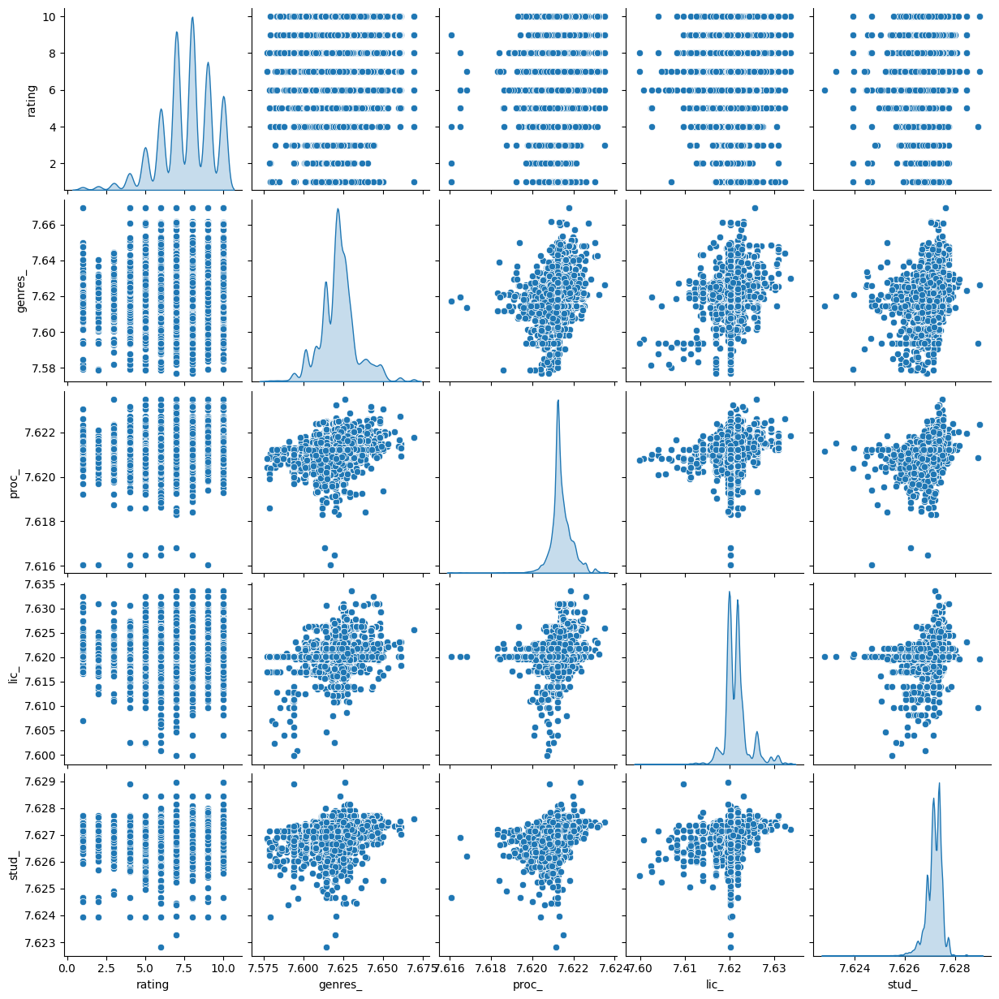

In [ ]:
columns =["genres_", "proc_", "lic_", "stud_"]
sns.pairplot(data = user_score.sample(frac = 0.001).merge(anime[columns], left_on = "anime_id", right_index = True).drop(["user_id", "anime_id"], axis = 1), diag_kind = "kde")

To facilitate processing, the "Duration" column, representing anime duration, will be converted to minutes and stored as integers. This transformation ensures a more straightforward representation of the duration in a format that is easier to work with in subsequent analysis.


In [ ]:
anime.Duration.unique()[:10]

array(['24 min per ep', '1 hr 55 min', '25 min per ep', '23 min per ep',
       '27 min per ep', '24 min', '22 min per ep', '1 hr 44 min',
       '1 hr 26 min', '1 hr 22 min'], dtype=object)

In [ ]:
def convert_duration(row):

  hour = re.compile(r"\d+ hr").findall(row)
  min = re.compile(r"\d+ min").findall(row)
  sec = re.compile(r"\d+ sec").findall(row)

  duration = 0

  if len(hour) != 0:
    duration += float(hour[0][:-3])*60

  if len(min) != 0:
    duration += float(min[0][:-4])

  if len(sec) != 0:
    duration += float(sec[0][:-4])/60

  return duration

anime["Duration"] = anime.Duration.apply(convert_duration)

Upon observing the regression plot of duration against rating, it appears that the two variables are largely independent. The change in rating does not exhibit significant differences in the variation of duration. This insight suggests that duration may not be a strong predictor of rating.


<Axes: xlabel='rating', ylabel='Duration'>

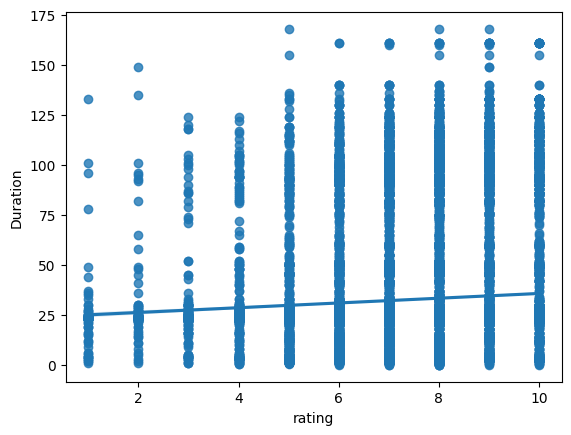

In [ ]:
sns.regplot(data = user_score.sample(frac = 0.001).merge(anime[["Duration"]], left_on = "anime_id", right_index = True).drop(["user_id", "anime_id"], axis = 1), x = "rating", y ="Duration")

Columns with object datatype and less than 6 unique categories will be converted into one-hot encoding. This transformation enhances the representation of categorical variables, preserving their information while simplifying the format for more effective analysis.


In [ ]:
#get columns less than six categories
def get_columns(df):

  columns = df.select_dtypes("object").columns

  for c in columns:
    if df[c].unique().shape[0]>5:
      columns = columns.drop(c)

  return columns

In [ ]:
#convert to one hot

dummy_columns = get_columns(anime)
anime = pd.get_dummies(anime, columns = dummy_columns)

The remaining object columns will be transformed into numerical values using target encoding. This involves encoding with a fraction of 0.2 sampled from the target variable.

In [ ]:
from sklearn.preprocessing import TargetEncoder

object_columns = anime.select_dtypes("object").columns

obj_rating = user_score[["anime_id", "rating"]].sample(frac = 0.2).merge( anime[object_columns], left_on = "anime_id", right_index = True ).drop("anime_id", axis = 1)
target_encoder = TargetEncoder(target_type = "continuous")
target_encoder.fit( obj_rating[object_columns], obj_rating["rating"] )
anime[object_columns] = target_encoder.transform( anime[object_columns])
obj_rating[object_columns] = target_encoder.transform( obj_rating[object_columns] )

The observed chart indicates that the encoded columns exhibit the properties of multiple peaks, with notable differences in the dispersion of data. This variance may be attributed to the limited number of categories in our dataset, leading to lower variation in values. Further exploration and consideration of potential adjustments are needed to optimize the encoding process and enhance the model's predictive capabilities.


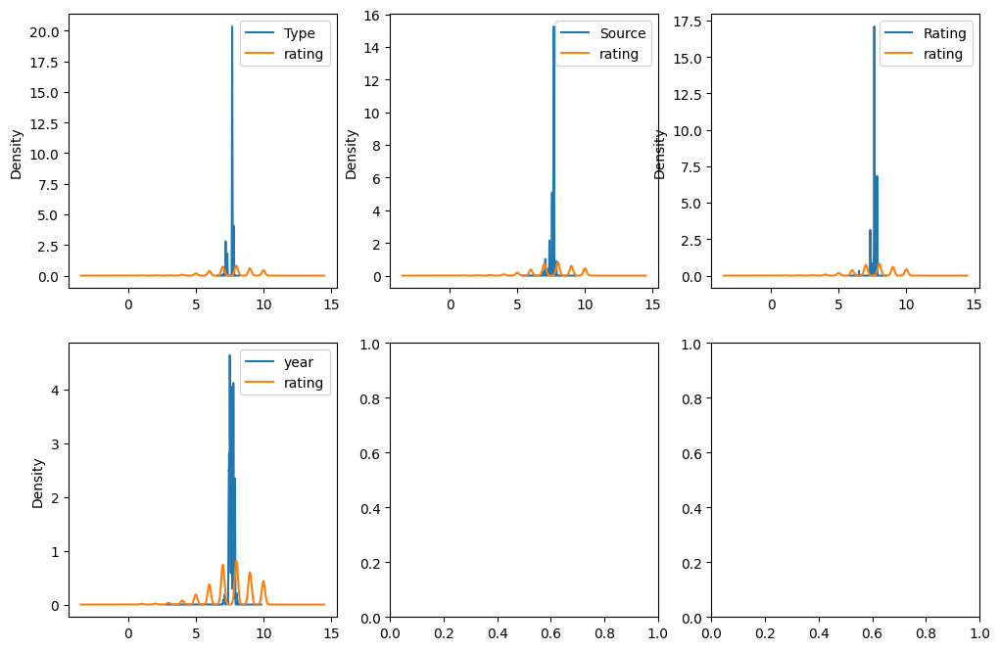

In [ ]:
del zip
fig, ax = plt.subplots(2,3, figsize = (12, 8))
ax = ax.flatten()

for c,a in zip(list(object_columns), ax):
  obj_rating[ [c, "rating"] ].sample(frac = 0.1).plot.kde(ax = a)

In [ ]:
del obj_rating
gc.collect()

70

## Feature Creation and Further Feature Selection

This section involves the creation of new features to provide additional information or enhance machine processing based on domain knowledge. Additionally, further feature selection using mutual information will be conducted, going beyond intuition to identify the most informative features for our analysis.


### User Detail

The "Birthday" column has been transformed into the "Age" column, a feature believed to be more informative. This transformation enhances the representation of user information in a way that is potentially more meaningful for analysis and model training.


In [ ]:
user_detail["Birthday"] = ( np.datetime64("2023-11-17") - np.array(user_detail["Birthday"], dtype = "datetime64[D]") ) / np.timedelta64("365", "D")
user_detail["Birthday"] = min_max_scaling(user_detail["Birthday"])

In [ ]:
col_rating = user_score.sample(frac = 0.1).merge(user_detail, left_on = "user_id", right_index = True).drop(["user_id", "anime_id"], axis = 1)

The graph below illustrates the distribution of rating against each column. It appears that the majority of columns exhibit a nearly independent relationship with our target variable, which is rating. This observation suggests that most columns may not have a strong linear correlation with the target, emphasizing the importance of more sophisticated feature selection techniques such as mutual information.


In [ ]:
columns = ['Birthday', 'Days Watched', 'Watching', 'Completed', 'On Hold', 'Dropped', 'Plan to Watch', 'Total Entries', 'Rewatched', 'Episodes Watched']

#merge with target column
col_rating = user_score.sample(frac = 0.1).merge(user_detail[columns], left_on = "user_id", right_index = True)

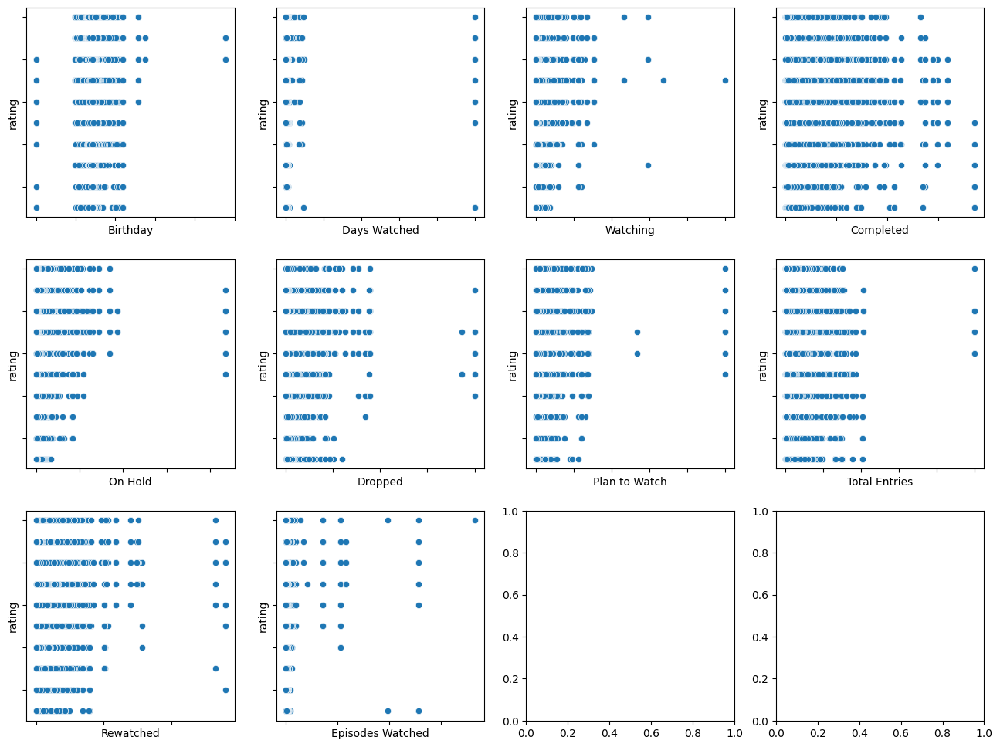

In [ ]:
fig, ax = plt.subplots(3, 4, figsize = (16,12) )
ax = ax.flatten()

for i, col in enumerate( col_rating.columns.drop(["rating","user_id", "anime_id"]) ):
  sns.scatterplot(data = col_rating[["rating", col]].sample(frac = 0.4), x = col, y = "rating", ax = ax[i])
  ax[i].tick_params(axis = "x", labelbottom = False)
  ax[i].tick_params(axis = "y", labelleft = False)

In [ ]:
del col_rating
gc.collect()

360

Next, we will perform feature selection based on mutual information. Before that, it is necessary to join the user details with the rating column, which is our target, in the user_score dataset.


In [ ]:
from sklearn.feature_selection import mutual_info_regression

columns = user_detail.columns

#merging user score and user detail
user_rating = user_score.sample(frac = 0.1).merge( user_detail, left_on = "user_id", right_index = True ).drop(["user_id", "anime_id"], axis = 1)

#conducting mutual information
mi_user_detail = mutual_info_regression(user_rating[columns] , user_rating[ "rating" ])
mi_user_detail = pd.Series(mi_user_detail, index = columns,  name = "MI Scores"  ).sort_values(ascending = False)

In [ ]:
mi_user_detail

Mean Score           0.161961
Episodes Watched     0.071283
Days Watched         0.036878
Completed            0.035888
Total Entries        0.035268
Birthday             0.023965
Dropped              0.019988
Plan to Watch        0.007505
On Hold              0.006564
Rewatched            0.005178
Watching             0.002627
Gender_UNK           0.001892
Gender_Male          0.001881
Gender_Female        0.001195
Gender_Non-Binary    0.001019
Name: MI Scores, dtype: float64

In the feature selection process based on mutual information, only the top 8 features will be retained.


In [ ]:
dropped_user_detail_col = list(mi_user_detail[8:].index )
dropped_user_detail_col

['On Hold',
 'Rewatched',
 'Watching',
 'Gender_UNK',
 'Gender_Male',
 'Gender_Female',
 'Gender_Non-Binary']

In [ ]:
user_detail = user_detail.drop(dropped_user_detail_col, axis = 1)

del user_rating
gc.collect()

324

### Anime

To address the challenge of storing high-dimensional vectors in pandas, a solution involves discretization. The vectors will be subjected to k-means clustering, dividing them into fifteen distinct clusters and perform target encoding again.


In [ ]:
from sklearn.cluster import KMeans

kmean = KMeans(n_clusters = 15).fit(synopsis_vec)
anime["Synopsis_cat"] = kmean.labels_

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


In [ ]:
from sklearn.preprocessing import TargetEncoder

syn_rating = user_score[["anime_id", "rating"]].sample(frac = 0.2).merge( anime["Synopsis_cat"], left_on = "anime_id", right_index = True ).drop("anime_id", axis = 1)
target_encoder = TargetEncoder(target_type = "continuous")
target_encoder.fit( syn_rating[["Synopsis_cat"]], syn_rating["rating"] )

TargetEncoder(target_type='continuous')

In [ ]:
anime["Synopsis_cat"] = target_encoder.transform( anime[["Synopsis_cat"]])

To conduct mutual information analysis for anime, it is necessary to join the dataset with the target variable, which is the rating in the user score dataset.


In [ ]:
from sklearn.feature_selection import mutual_info_regression

anime_rating = user_score[["anime_id", "rating"]].sample(frac = 0.1).merge( anime, left_on = "anime_id", right_index = True ).drop("anime_id", axis = 1)
mi_anime = mutual_info_regression(anime_rating.drop("rating", axis = 1) , anime_rating[ "rating" ])
mi_anime = pd.Series(mi_anime, index = anime.columns, name = "MI Scores"  ).sort_values(ascending = False)

In [ ]:
mi_anime

Members                    0.108477
Scored By                  0.107976
Rank                       0.107257
Popularity                 0.105043
Score                      0.094807
Favorites                  0.085613
proc_                      0.083953
genres_                    0.049434
stud_                      0.038093
lic_                       0.025723
Duration                   0.017616
Episodes                   0.017530
year                       0.008194
Synopsis_cat               0.008128
Type                       0.008094
Rating                     0.007267
Source                     0.006269
spring_winter              0.001342
spring_fall                0.001101
Status_Finished Airing     0.000701
Status_Currently Airing    0.000577
spring_spring              0.000448
spring_UNK                 0.000328
spring_summer              0.000291
Status_Not yet aired       0.000188
Name: MI Scores, dtype: float64

In the process of mutual information analysis for anime, a decision has been made to drop the 10 columns with the lowest mutual information scores.

In [ ]:
mi_anime[-10:].index
anime.drop( mi_anime[-10:].index, inplace = True, axis = 1 )

In [ ]:
del anime_rating
gc.collect()

0

### User Score

The final step involves merging the three datasets into a single dataset. Due to the potential size constraints, the merging process will be conducted in chunks, with each chunk containing 10,000 records. The merged chunks will then be written into a CSV file one by one, ensuring the creation of a comprehensive dataset for further analysis.


In [ ]:
header = True
for i in range(0, user_score.size, 10000 ):
  merge_df = user_score.iloc[ i:min(i+10000, user_score.size), : ].merge(anime, left_on = "anime_id", right_index = True)
  merge_df = merge_df.merge(user_detail, left_on = "user_id", right_index = True)
  merge_df = merge_df.to_csv("anime_data.csv", mode = "a", header = header)

  header = False

A substantial dataset, named "anime_data.csv," has been successfully produced, containing over 8 GB of data. This dataset incorporates information from multiple sources, providing a comprehensive foundation for extensive analysis and model development in subsequent phases.


In [ ]:
!ls -l

total 15235944
-rw-r--r-- 1 root root 8236348975 Nov 26 03:47 anime_data.csv
-rw-r--r-- 1 root root   15924739 Nov 26 02:33 anime-dataset-2023.csv
-rw-r--r-- 1 root root    9722413 Nov 26 02:33 anime-filtered.csv
-rw-r--r-- 1 root root 4549801910 Nov 26 02:34 final_animedataset.csv
drwxr-xr-x 1 root root       4096 Nov 21 14:24 sample_data
-rw-r--r-- 1 root root   12751488 Nov 24 10:52 synopsis_vec.npy
-rw-r--r-- 1 root root 1545214210 Nov 26 02:34 user-filtered.csv
-rw-r--r-- 1 root root   73927314 Nov 26 02:34 users-details-2023.csv
-rw-r--r-- 1 root root 1157881770 Nov 26 02:34 users-score-2023.csv


In [ ]:
next(pd.read_csv("anime_data.csv", chunksize = 100, index_col = 0)).head()

,user_id,anime_id,rating,Score,Type,Episodes,Duration,Rank,Popularity,Favorites,...,stud_,Synopsis_cat,Birthday,Days Watched,Mean Score,Completed,Dropped,Plan to Watch,Total Entries,Episodes Watched
0,1,21,9,8.69,7.687604,25.0,24.0,55.000000,20,198986,...,7.627073,7.728616,0.296316,0.001351,0.737,0.017617,0.006485,0.002935,0.016078,0.000251
1,1,48,7,6.95,7.687604,26.0,24.0,4172.000000,1243,1343,...,7.626880,7.728616,0.296316,0.001351,0.737,0.017617,0.006485,0.002935,0.016078,0.000251
2,1,320,5,6.54,7.206906,2.0,26.0,9960.770167,2485,302,...,7.626892,7.728616,0.296316,0.001351,0.737,0.017617,0.006485,0.002935,0.016078,0.000251
3,1,49,8,7.29,7.206906,5.0,30.0,2542.000000,2832,246,...,7.626818,7.651055,0.296316,0.001351,0.737,0.017617,0.006485,0.002935,0.016078,0.000251
4,1,304,8,7.54,7.797153,1.0,106.0,1590.000000,3195,99,...,7.626818,7.728616,0.296316,0.001351,0.737,0.017617,0.006485,0.002935,0.016078,0.000251


## Conclusion

In the process of feature engineering for the development of a recommendation system for anime, a thorough exploration and transformation of the dataset were conducted. The dataset, consisting of three primary CSV files with a vast amount of records and columns, presented a challenge in terms of size and complexity. Initial steps involved addressing missing values strategically based on domain knowledge, replacing "UNKNOWN" values, and conducting basic exploratory data analysis (EDA) to understand the dataset's structure. Feature preprocessing included transforming the "Birthday" column, handling missing values in various columns, and applying one-hot encoding to categorical columns like Genres, Producers, Licensors, and Studios. Further EDA revealed relationships between features and the target variable (rating), prompting the utilization of TensorBoard for interactive visualization of vector representations and min-max scaling for certain columns.

Feature creation and selection involved generating new features such as "Age" from the "Birthday" column, leveraging BERT for vector representations of anime synopses, and conducting feature selection based on mutual information. Encoding and discretization techniques were applied, including target encoding for certain categorical columns and k-means clustering for high-dimensional vectors. The merging process was executed in chunks due to dataset size constraints, resulting in the production of a final dataset, "anime_data.csv," exceeding 8 GB in size.

In addition to the initial feature engineering steps, further insights were gained through targeted imputation and feature retention decisions. Missing values in the "Episodes" column were imputed based on the logical relationship with the "Type" column, ensuring contextually appropriate imputations. The decision to retain the history record of a user's ratings to different anime was motivated by the recognition of its potential significance in predicting future user behavior, contributing to the development of a more personalized recommendation system.

In addition to this, it was evident that several features within the current dataset may not carry significant utility. However, a key finding highlighted the importance of retaining the historical record of a user's ratings for different anime. This historical context proves valuable in predicting a user's potential ratings for other anime in the future. Consequently, this crucial historical information, including unique user identifiers for record distinction, as well as pertinent characteristics about an anime such as its synopsis, genres, and production details, has been intentionally preserved within the dataset.